# Preprocessing of _multimodal liver regeneration atlas_

We pre-process the _Multimodal liver regeneration atlas_[[1]](https://doi.org/10.1101/2023.02.24.529873).
We use the `Seurat` object(`GSE223560_seurat_object`).

[[1] Matchett, Kylie P., John W. Wilson-Kanamori, Jordan R. Portman, Andreas Kapourani, Frederic Fercoq, Stephanie May, John BG Mackey et al. "Multimodal decoding of human liver regeneration." bioRxiv (2023): 2023-02.](https://doi.org/10.1101/2023.02.24.529873)


## Import packages

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import sys

import scanpy as sc
import squidpy as sq
import numpy as np
import pandas as pd
import seaborn as sns
import warnings

from anndata import AnnData
import anndata2ri

import matplotlib.pyplot as plt
import copy as copy


In [3]:
warnings.simplefilter("ignore", UserWarning)
warnings.simplefilter("ignore", FutureWarning)

In [4]:
sys.path.append("../../")
from paths import DATA_DIR, FIG_DIR

In [5]:
# Activate the anndata2ri conversion between SingleCellExperiment and AnnData
anndata2ri.activate()

# Loading the rpy2 extension enables cell magic to be used
# This runs R code in jupyter notebook cells
%load_ext rpy2.ipython

## set parameters

In [6]:
import seaborn as sns
fontsize = 25
size = 4
plt.rcParams["svg.fonttype"] = "none"
plt.rcParams["pdf.fonttype"] = 42
plt.rcParams["savefig.transparent"] = True
plt.rcParams["figure.figsize"] = (size, size)

plt.rcParams["axes.titlesize"] = 15
plt.rcParams["axes.titleweight"] = 500
plt.rcParams["axes.titlepad"] = 8.0
plt.rcParams["axes.labelsize"] = fontsize
plt.rcParams["axes.labelweight"] = 500
plt.rcParams["axes.linewidth"] = 1.2
plt.rcParams["axes.labelpad"] = 6.0
plt.rcParams["axes.spines.top"] = False
plt.rcParams["axes.spines.right"] = False


plt.rcParams["font.size"] = fontsize
# plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = ['Helvetica', "Computer Modern Sans Serif", "DejaVU Sans"]
plt.rcParams['font.weight'] = 500

plt.rcParams['xtick.labelsize'] = fontsize-4
plt.rcParams['xtick.minor.size'] = 1.375
plt.rcParams['xtick.major.size'] = 2.75
plt.rcParams['xtick.major.pad'] = 2
plt.rcParams['xtick.minor.pad'] = 2

plt.rcParams['ytick.labelsize'] = fontsize-4
plt.rcParams['ytick.minor.size'] = 1.375
plt.rcParams['ytick.major.size'] = 2.75
plt.rcParams['ytick.major.pad'] = 2
plt.rcParams['ytick.minor.pad'] = 2

plt.rcParams["legend.fontsize"] = fontsize+4
plt.rcParams['legend.handlelength'] = 1.4 
plt.rcParams['legend.numpoints'] = 1
plt.rcParams['legend.scatterpoints'] = 1
plt.rcParams['legend.frameon'] = False

plt.rcParams['lines.linewidth'] = 1.7

DPI = 300

sns.set(rc={"figure.dpi":300, "savefig.dpi":300})
plt.style.use("seaborn-whitegrid")
sns.set_style("whitegrid", {"xtick.direction": "out", "xtick.major.size": 3.0, "xtick.minor.size": 3.0,
                            "ytick.color": ".15", "ytick.direction": "out", "ytick.major.size": 3.0, 
                            "ytick.minor.size": 3.0, "font": ["DejaVu Sans"], "font.scale": 2, 
                            "legend.frameon":"True"})

<ipython-input-6-d61a678d3ef3>:48: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn-whitegrid")


## load and preprocess data

In [7]:
%%R -i DATA_DIR -o adatas_dict -o coords_dict -o images_dict
suppressPackageStartupMessages(library(Seurat))

data_mouse = readRDS(paste(DATA_DIR, "GSE223560_seurat_object.rds", sep=""))

adatas_dict = list()
coords_dict = list()
images_dict = list()
for (sample in names(data_mouse)) {
    for (sample_cur in data_mouse[sample]) {
        adatas_dict[sample] = as.SingleCellExperiment(sample_cur)
        coords_dict[sample] = list(GetTissueCoordinates(sample_cur))
        images_dict[sample] = list(GetImage(sample_cur, mode="raw"))
    }
}


In [8]:
adatas_dict = dict(adatas_dict.items())
coords_dict = dict(coords_dict.items())
images_dict = dict(images_dict.items())

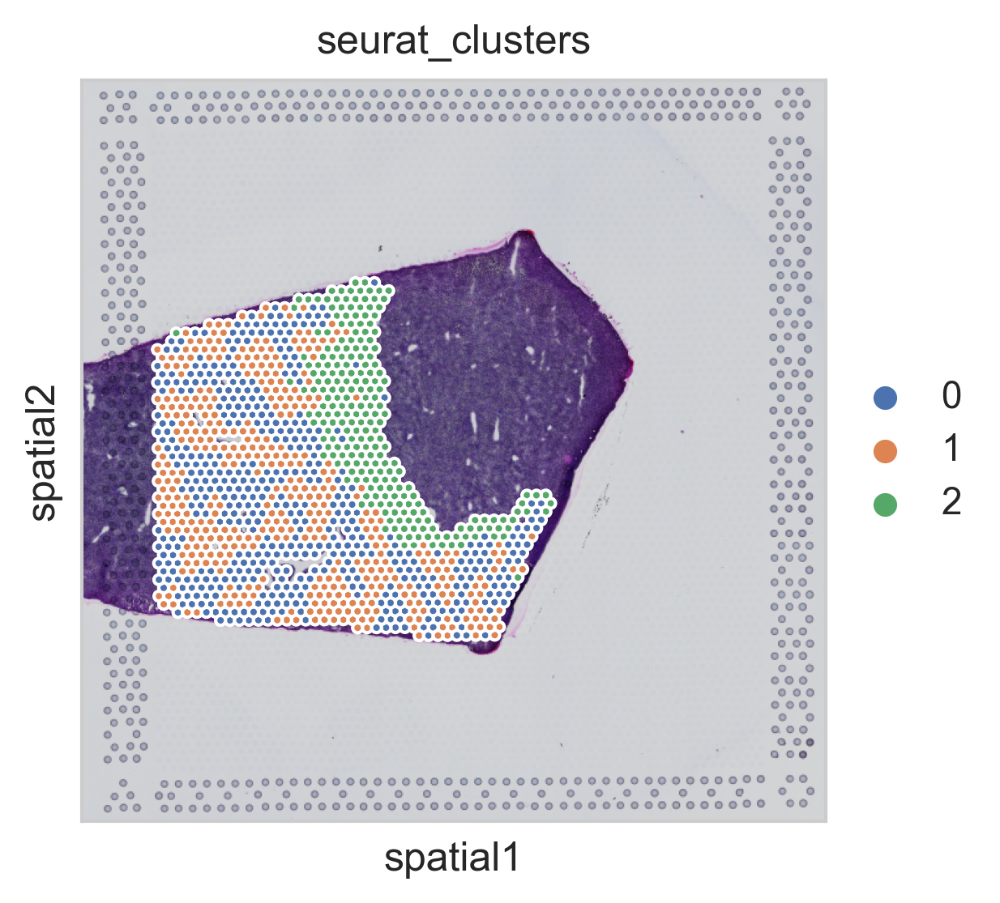

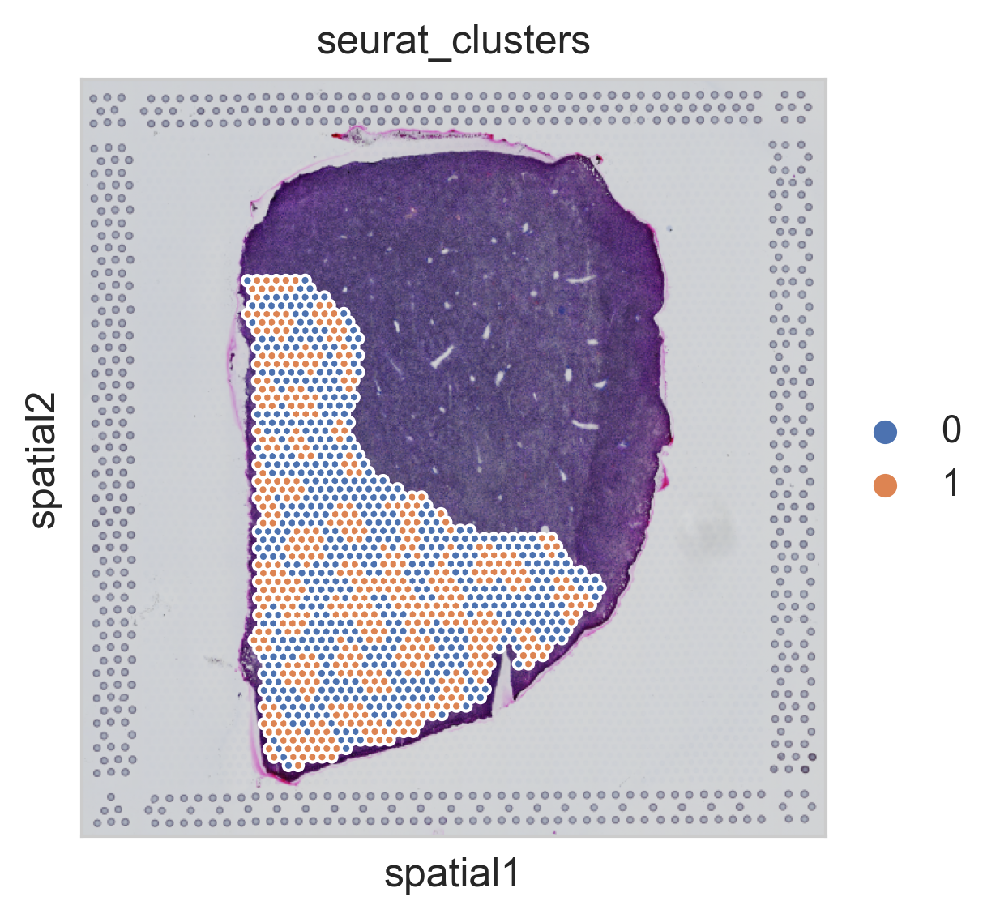

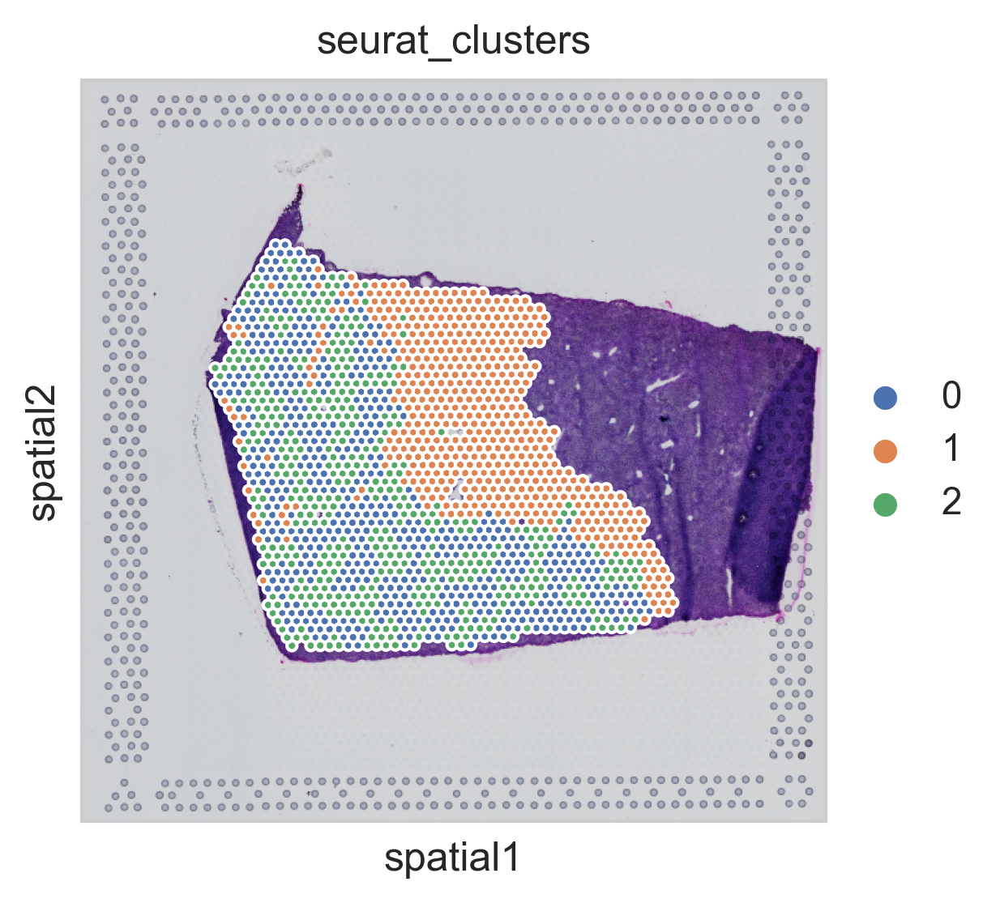

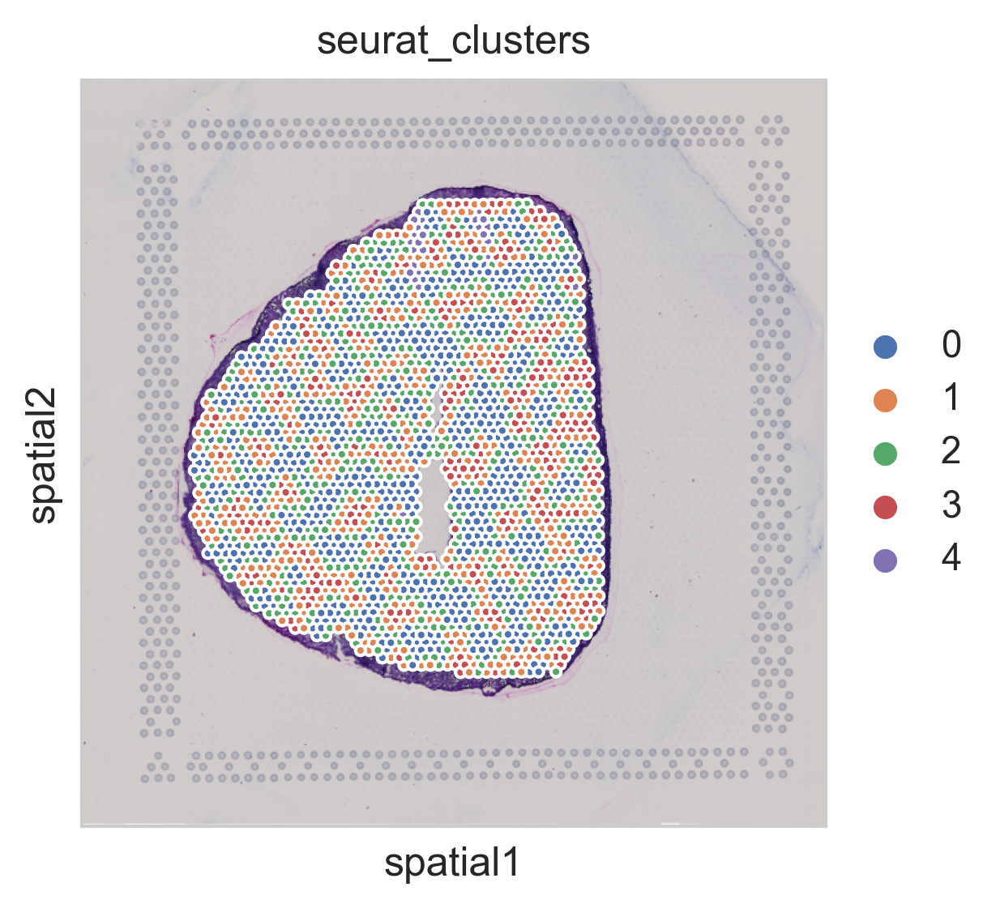

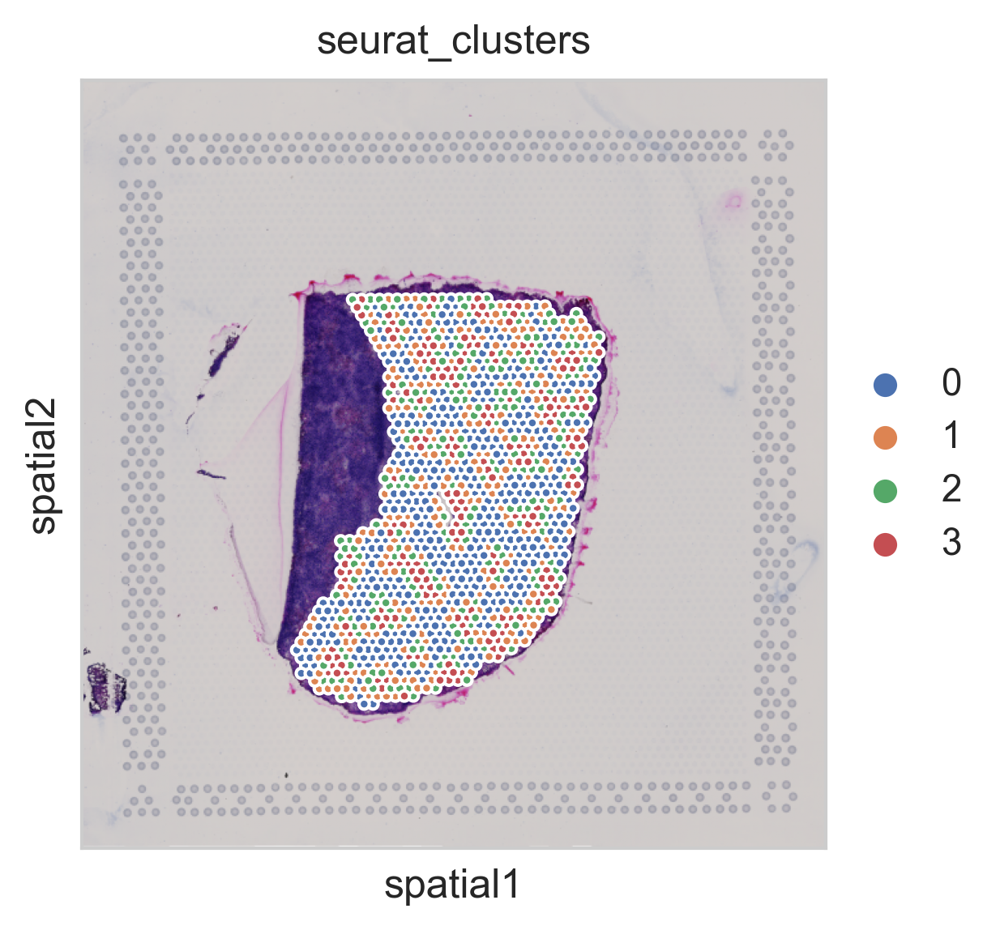

...

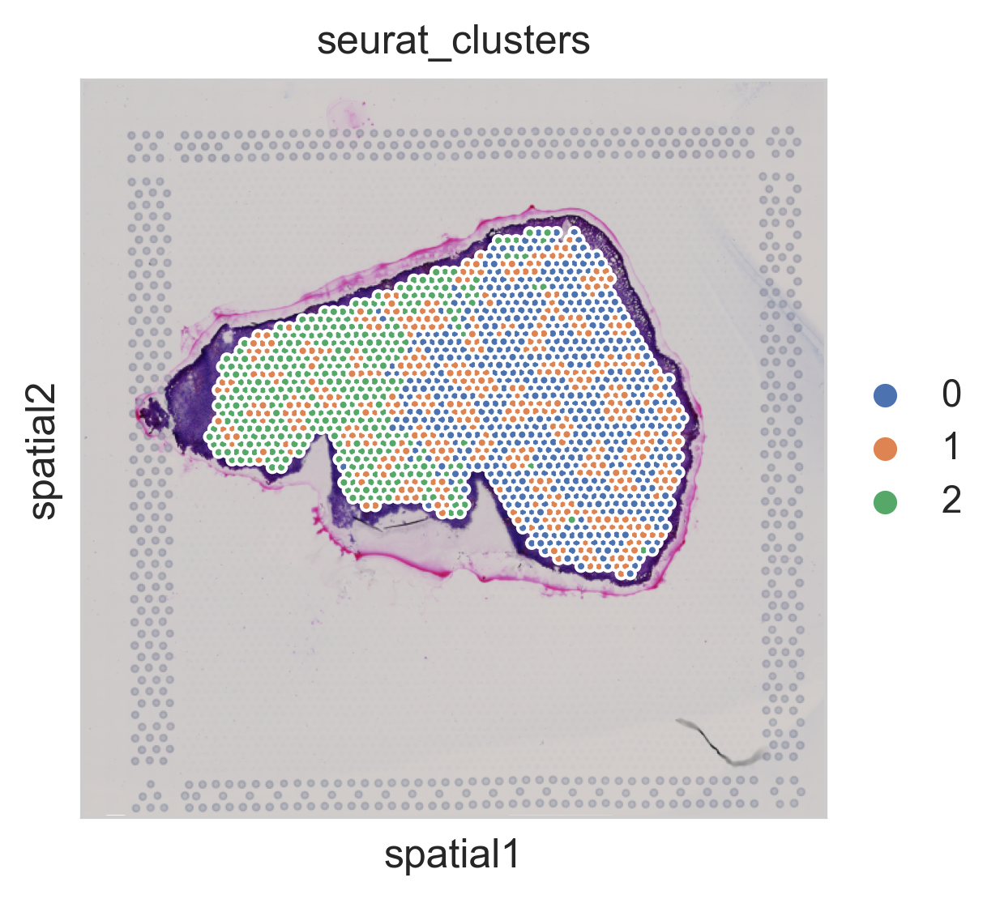

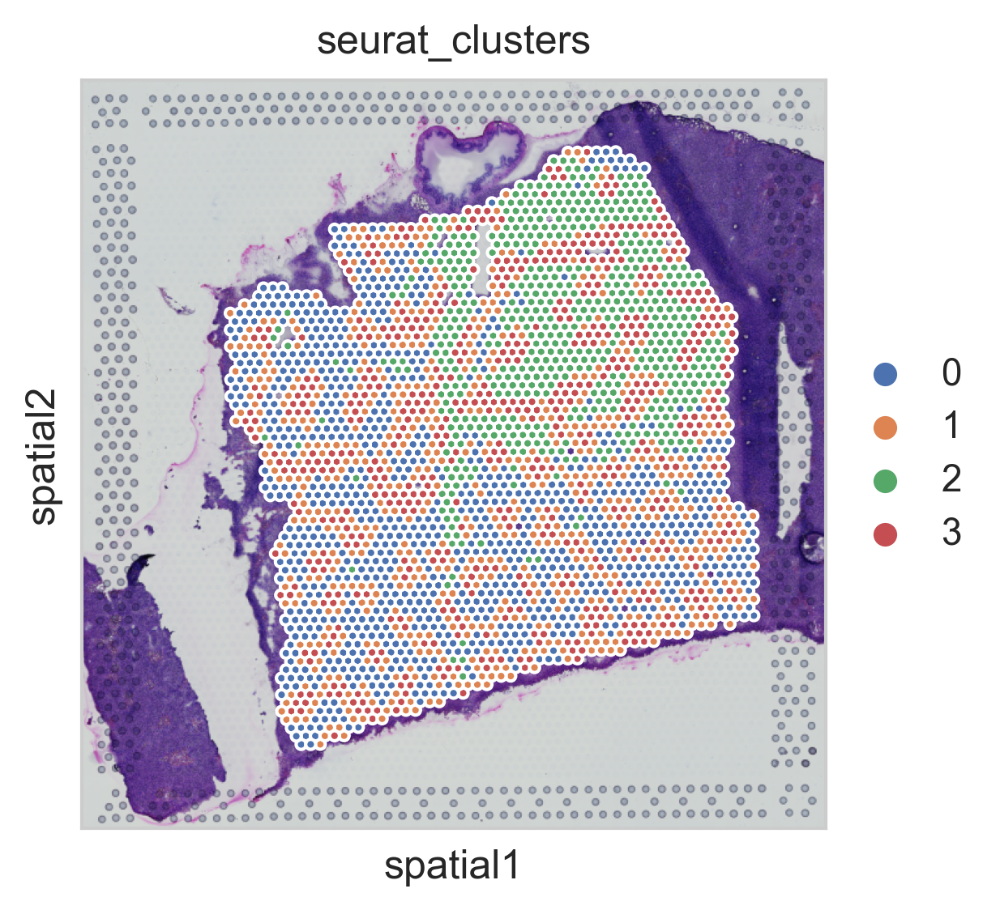

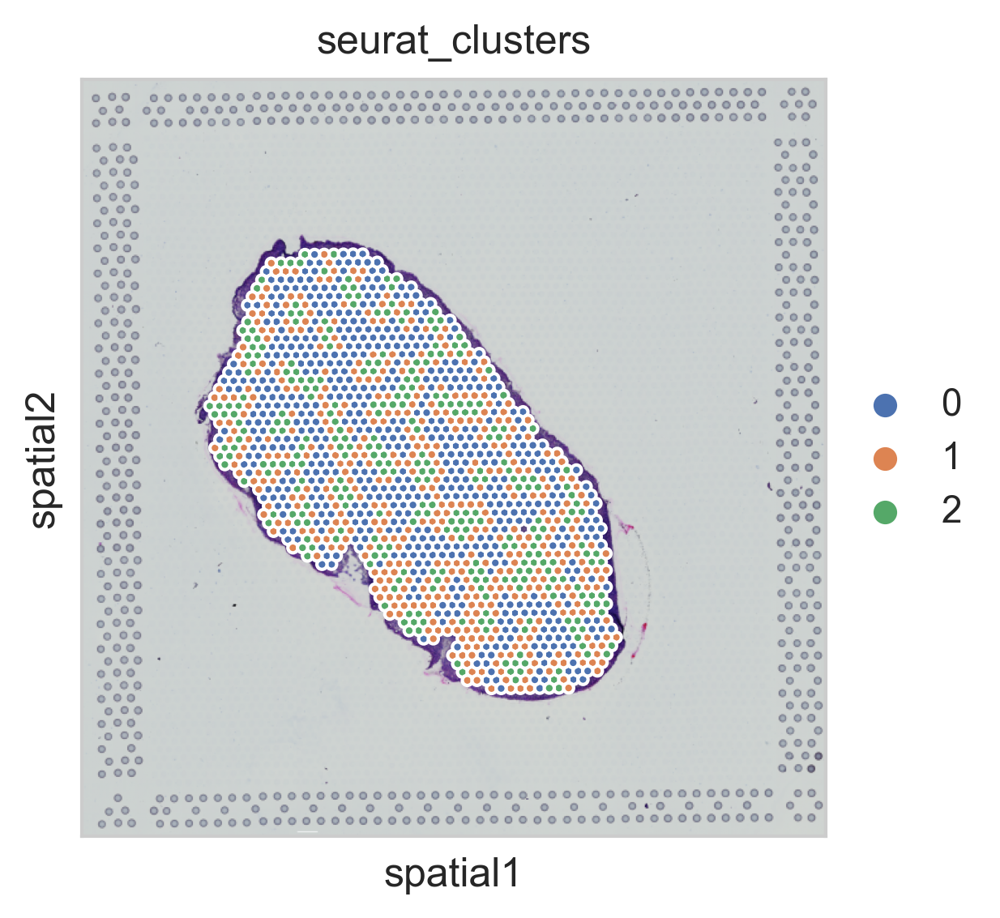

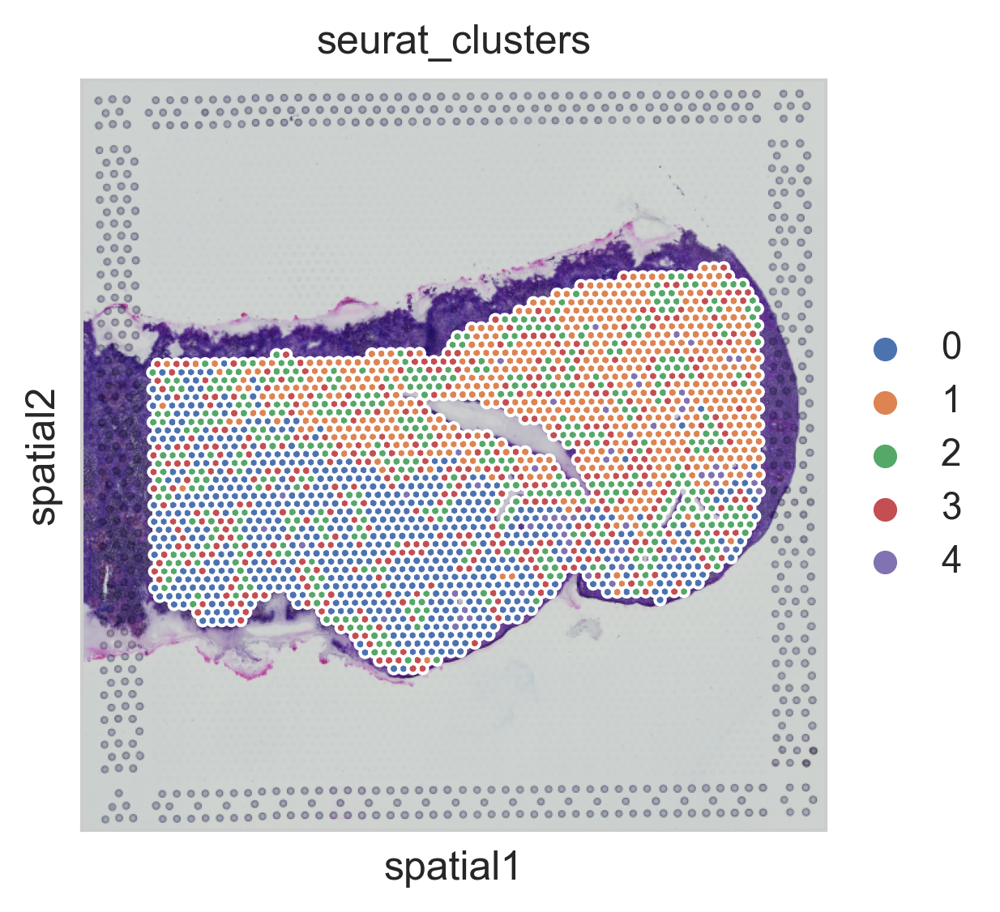

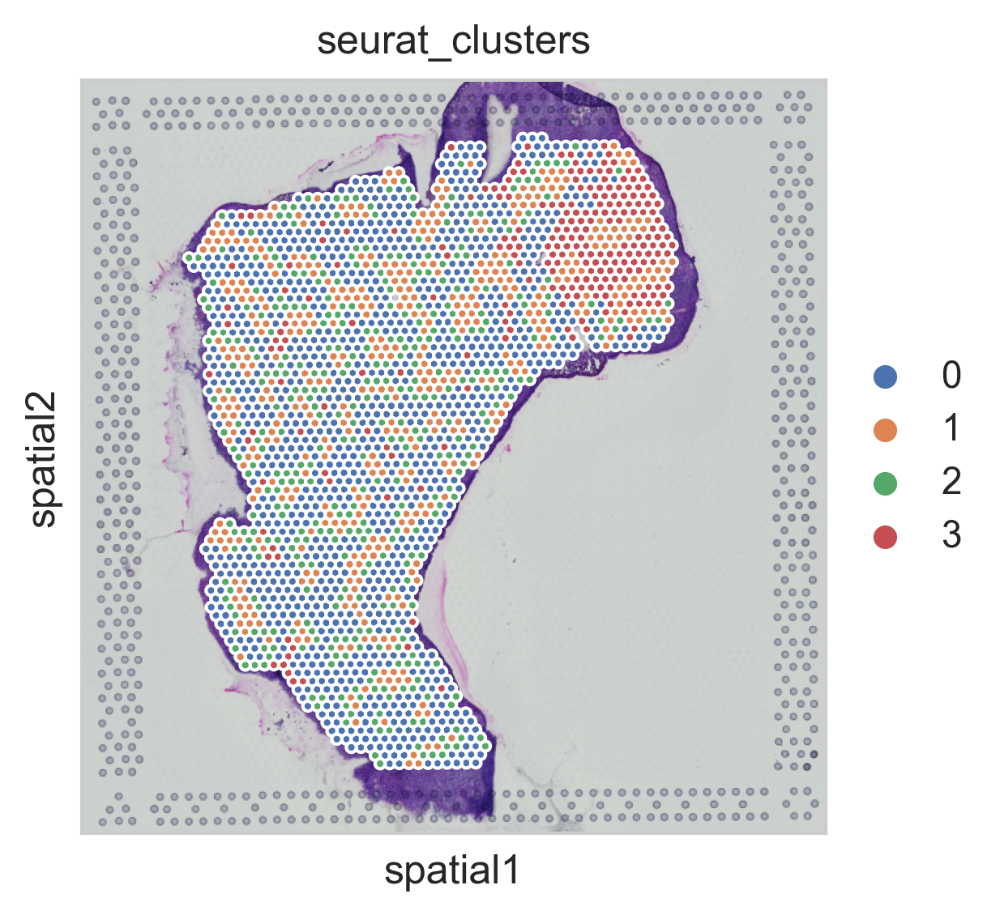

In [9]:
for key, adata in adatas_dict.items():
    adata.obsm["spatial"] = coords_dict[key][["imagecol", "imagerow"]].values
    adata.uns["spatial"] = {
        key: {
            "scalefactors": 
            {
                "fiducial_diameter_hires": 1, 
                "spot_diameter_fullres": 1, 
                "tissue_hires_scalef": 1,
                "tissue_lowres_scalef":1, 
            },
            "images": {"hires":images_dict[key]}
        }
    }
    sq.pl.spatial_scatter(adata, color="seurat_clusters", size=8)
    plt.show()
    
    

### Basic preprocessing

In [10]:
for key, adata in adatas_dict.items():
    print(key)
    sc.pp.filter_cells(adata, min_genes=200)
    sc.pp.filter_genes(adata, min_cells=3)
    sc.pp.highly_variable_genes(adata, flavor="seurat_v3", n_top_genes=2000, subset=False)
    sc.pp.normalize_total(adata)
    sc.pp.log1p(adata)
    sc.pp.pca(adata)
    sc.pp.neighbors(adata)
    sc.tl.umap(adata)
    
    adata.write(DATA_DIR + f"adata_{key}_mouse.h5ad")
    

HEA2
HEA3
HEA4
APAP_24h_S1
APAP_24h_S2
APAP_36h_S1
APAP_36h_S2
APAP_48h_S1
APAP_48h_S2
APAP_48h_S3
APAP_48h_S4


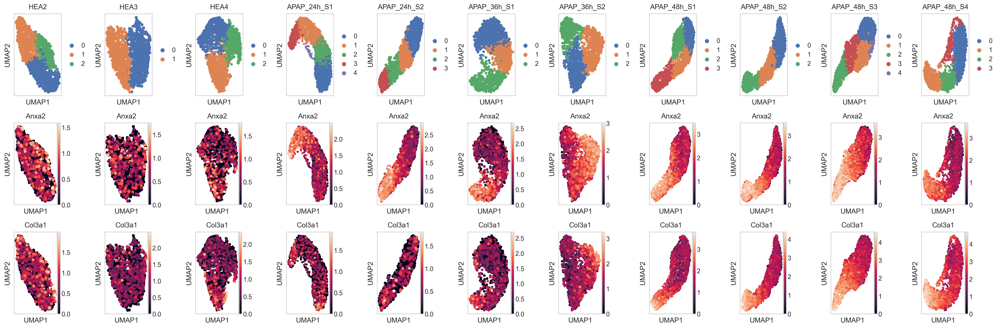

In [11]:
fig, axs = plt.subplots(3, len(adatas_dict), figsize=(24, 8))
for i, (key, adata) in enumerate(adatas_dict.items()):
    sc.pl.umap(adata, color=["seurat_clusters"], ax=axs[0, i], show=False)
    sc.pl.umap(adata, color=["Anxa2"], ax=axs[1, i], show=False)
    sc.pl.umap(adata, color=["Col3a1"], ax=axs[2, i], show=False)
    
    axs[0, i].set_title(key)

plt.tight_layout()
plt.show()

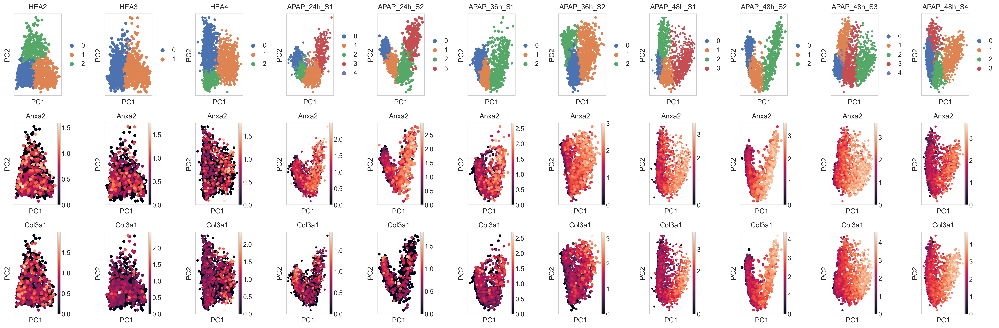

In [14]:
fig, axs = plt.subplots(3, len(adatas_dict), figsize=(24, 8))
for i, (key, adata) in enumerate(adatas_dict.items()):
    sc.pl.pca(adata, color=["seurat_clusters"], ax=axs[0, i], show=False)
    sc.pl.pca(adata, color=["Anxa2"], ax=axs[1, i], show=False)
    sc.pl.pca(adata, color=["Col3a1"], ax=axs[2, i], show=False)
    
    axs[0, i].set_title(key)

plt.tight_layout()
plt.show()